# Отчет по предмету "Математические методы распознавания образов"
# студента группы 02121-ДМ Подрядчиков Владимира Валерьевича

## Лабораторная работа 1

Задача: разработать программу, детектирующую заданный цвет на сцене  

Входной поток поступает фотографии.
Выходными данными являются координаты центра объекта, которые выводятся на результирующее изображение рядом с самим объектом  
(Дополнительно 1) Определять размер объекта в пикселях

Подключиться к входному потоку  
Для каждого кадра входного потока:
* Преобразовать кадр в модель HSV (cv.cvtColor(frame, cv.COLOR_BGR2HSV))
* Разделить кадр на каналы (split)  

Для каждого канала:
* Построить бинарную карту (inRange) попадания каждого пиксела в искомый диапазон
* Применить медианный фильтр для отсечения выбросов
* Объединить бинарные маски каналов (bitwise_and)
* Найти центр объекта
* Вывести информацию на экран


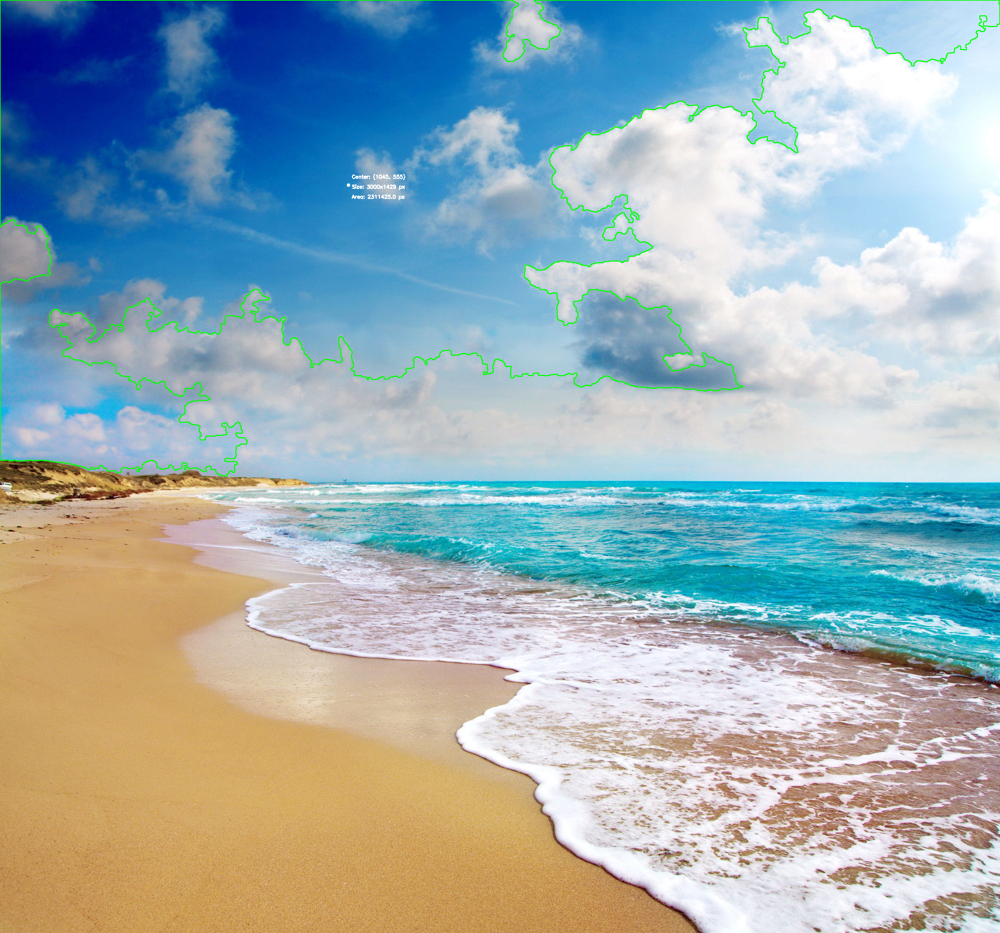

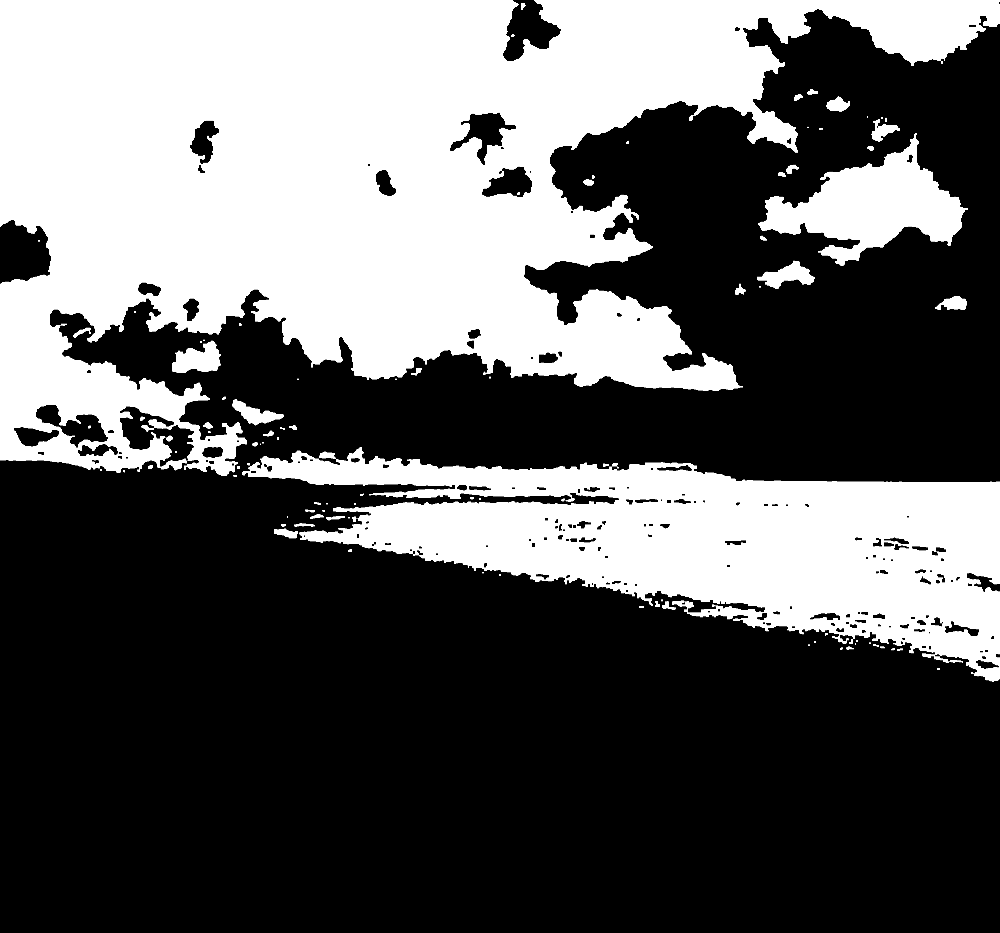

In [84]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def detect_color_object(input_source='sea.jpg', color_range=None, display_info=True):

    if color_range is None:
        color_range = {
            'lower1': np.array([0, 70, 50]),
            'upper1': np.array([10, 255, 255]),
            'lower2': np.array([170, 70, 50]),
            'upper2': np.array([180, 255, 255])
        }

    if isinstance(input_source, str):
        frame = cv2.imread(input_source)
        if frame is None:
            print("Ошибка загрузки изображения!")
            return

    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    mask1 = cv2.inRange(hsv, color_range['lower1'], color_range['upper1'])

    if color_range['lower2'] is not None and color_range['upper2'] is not None:
        mask2 = cv2.inRange(hsv, color_range['lower2'], color_range['upper2'])
        mask = cv2.bitwise_or(mask1, mask2)
    else:
        mask = mask1

    mask = cv2.medianBlur(mask, 5)
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)

        M = cv2.moments(largest_contour)
        if M["m00"] != 0:
            cX = int(M["m10"] / M["m00"])
            cY = int(M["m01"] / M["m00"])

            x, y, w, h = cv2.boundingRect(largest_contour)
            area = cv2.contourArea(largest_contour)

            cv2.drawContours(frame, [largest_contour], -1, (0, 255, 0), 2)
            cv2.circle(frame, (cX, cY), 5, (255, 255, 255), -1)

            if display_info:
                cv2.putText(frame, f"Center: ({cX}, {cY})", (cX + 10, cY - 20),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
                cv2.putText(frame, f"Size: {w}x{h} px", (cX + 10, cY + 10),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
                cv2.putText(frame, f"Area: {area:.1f} px", (cX + 10, cY + 40),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    cv2_imshow(frame)
    cv2_imshow(mask)

if __name__ == "__main__":
    blue_range = {
        'lower1': np.array([90, 50, 50]),
        'upper1': np.array([130, 255, 255]),
        'lower2': None,
        'upper2': None
    }
    detect_color_object(input_source='sea.jpg', color_range=blue_range)

## Лабораторная работа 2

Задача:  
Разработать программу, сшивающую изображения в панораму  
Этапы:  
* Для двух фотографий найти их ключевые точки, описать их, используя любой дескриптор (SIFT, SURF, ORB или др.) и провести их сопоставление. * Продемонстрировать результат.
Сшить изображения в панораму
* (Дополнительно 1) Произвести сшивание нескольких изображений (3 и более)

Алгоритм  
1. Считать входные изображения (imread)
2. Создать детектор/дескриптор (ORB_create, SIFT_create и т.д.)
3. На каждом изображении найти ключевые точки (detect) и посчитать дескрипторы (compute)
4. Сопоставить (knnMatch, match) дескрипторы, используя любой matcher (BFMatcher, FlannBasedMatcher)
5. Вывести на экран сопоставление (drawMatchesKnn, drawMatches)
6. Определить гомографию приклеиваемого изображения (findHomography)
7. Применить к приклеиваемому изображению перспективное преобразование (warpPerspective) и поместить оба исходных изображения на одну подложку (итоговое изображение)


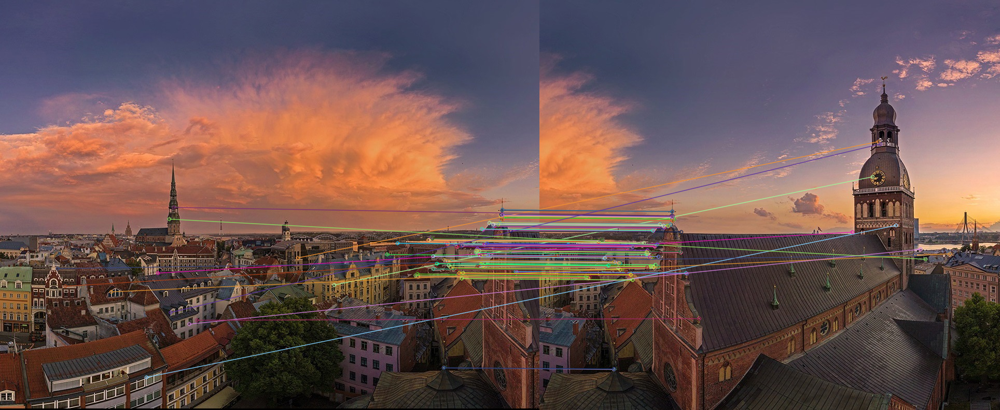

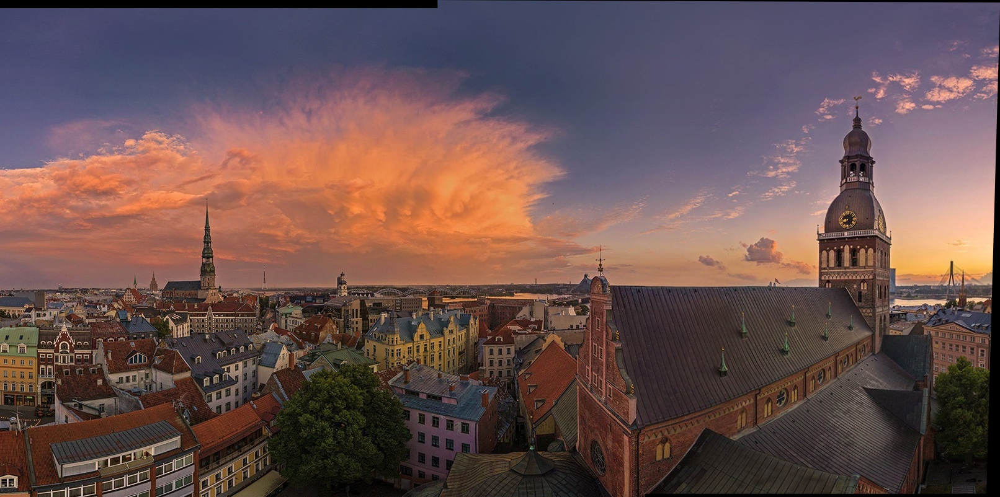

In [85]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def stitch_images(images, feature_detector='ORB', show_matches=False, min_matches=5):
    if isinstance(images[0], str):
        imgs = [cv2.imread(p) for p in images]
    else:
        imgs = images

    if feature_detector == 'SIFT':
        detector = cv2.SIFT_create()
    elif feature_detector == 'ORB':
        detector = cv2.ORB_create(nfeatures=2000)
    else:
        raise ValueError("Неподдерживаемый детектор")

    result = imgs[0]

    for i in range(1, len(imgs)):
        img1 = result
        img2 = imgs[i]

        kp1, des1 = detector.detectAndCompute(cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY), None)
        kp2, des2 = detector.detectAndCompute(cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY), None)

        matcher = cv2.BFMatcher()
        raw_matches = matcher.knnMatch(des1, des2, k=2)
        good_matches = [m for m, n in raw_matches if m.distance < 0.75 * n.distance]

        if show_matches:
            match_img = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, flags=2)
            cv2_imshow(match_img)

        if len(good_matches) < min_matches:
            print(f"Недостаточно совпадений ({len(good_matches)}) между изображениями {i - 1} и {i}")
            return None

        src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        H, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)

        h1, w1 = img1.shape[:2]
        h2, w2 = img2.shape[:2]
        corners_img2 = np.float32([[0, 0], [0, h2], [w2, h2], [w2, 0]]).reshape(-1, 1, 2)
        transformed_corners_img2 = cv2.perspectiveTransform(corners_img2, H)
        corners = np.concatenate((transformed_corners_img2, np.float32([[0,0],[0,h1],[w1,h1],[w1,0]]).reshape(-1,1,2)), axis=0)

        [x_min, y_min] = np.int32(corners.min(axis=0).ravel() - 0.5)
        [x_max, y_max] = np.int32(corners.max(axis=0).ravel() + 0.5)
        trans = [-x_min, -y_min]

        translation = np.array([[1, 0, trans[0]], [0, 1, trans[1]], [0, 0, 1]])

        output_shape = (x_max - x_min, y_max - y_min)
        warped_img2 = cv2.warpPerspective(img2, translation.dot(H), output_shape)

        warped_img2[trans[1]:h1 + trans[1], trans[0]:w1 + trans[0]] = img1

        result = warped_img2

    return result


image_paths = ["par_1.jpg", "par_2.jpg"]
panorama = stitch_images(image_paths, show_matches=True)

if panorama is not None:
    cv2_imshow(panorama)
    cv2.imwrite('improved_panorama.jpg', panorama)
else:
    print("Панорама не построена.")

## Лабораторная работа 3

Задача:
Разработать программу, детектирующую лица людей в потоковой фотографии с применением каскадного классификатора.
Этапы:
Выделить на сцене лица, применяя каскадный классификатор из базового набора opencv. Вывести результат


Найдено лиц после фильтрации: 2


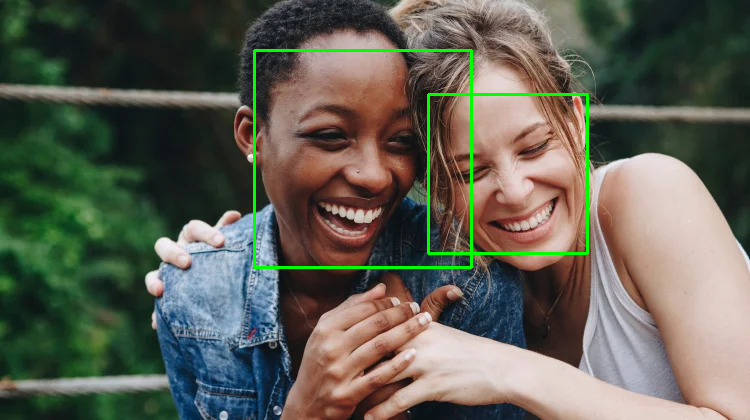

In [130]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

def detect_faces_improved(image_path):
    classifiers = [
        cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_alt2.xml'),
        cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_profileface.xml')
    ]

    img = cv2.imread(image_path)
    if img is None:
        print("Не удалось загрузить изображение")
        return

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.equalizeHist(gray)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    scaleFactor = 1.05
    minNeighbors = 1
    minSize = (100, 110)
    maxSize = (500, 500)

    all_faces = []

    for classifier in classifiers:
        faces = classifier.detectMultiScale(
            gray,
            scaleFactor=scaleFactor,
            minNeighbors=minNeighbors,
            minSize=minSize,
            maxSize=maxSize,
            flags=cv2.CASCADE_SCALE_IMAGE
        )
        for (x, y, w, h) in faces:
            all_faces.append((x, y, w, h))

    faces_clean = []
    for i, (x, y, w, h) in enumerate(all_faces):
        aspect_ratio = w / float(h)
        if aspect_ratio < 0.6 or aspect_ratio > 1.4:
            continue

        face_region = gray[y:y+h, x:x+w]
        brightness_variation = np.std(face_region)
        if brightness_variation < 20:
            continue

        overlap = False
        for (ex, ey, ew, eh) in faces_clean:
            dx = min(x + w, ex + ew) - max(x, ex)
            dy = min(y + h, ey + eh) - max(y, ey)
            if dx > 0 and dy > 0:
                area_overlap = dx * dy
                min_area = min(w * h, ew * eh)
                if area_overlap > 0.3 * min_area:
                    overlap = True

                    if w * h > ew * eh:
                        faces_clean.remove((ex, ey, ew, eh))
                        faces_clean.append((x, y, w, h))
                    break
        if not overlap:
            faces_clean.append((x, y, w, h))

    output_img = img.copy()
    for (x, y, w, h) in faces_clean:
        cv2.rectangle(output_img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    print(f"Найдено лиц после фильтрации: {len(faces_clean)}")
    cv2_imshow(output_img)

image_path = 'human2.jpg'
detect_faces_improved(image_path)